## Import the code 
All the code are in the `analysis.py`

In [47]:
%load_ext autoreload
%autoreload 2

import analysis
import pandas as pd
from matplotlib import pyplot as plt

trainDirPath='/data/gpueval/imageProcessing/peguo0/cowFace/data/cropped/cowId.faceBennett.20200401-20200731.color_top1000/train'

# Test set: 21 days of Aug 2020 
datasetFn="cowId.faceBennett.20200801-20200821.fv" # Use Epoch 80 to get this feature vector.


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Summary of the training set

Training data cover 4 months, from 1 April to 31 July 2020

Number of cow: 900
Quantile at [0, 0.25, 0.5, 0.75, 1]
[ 25.  45.  66.  76. 152.]
Total number of images: 55649



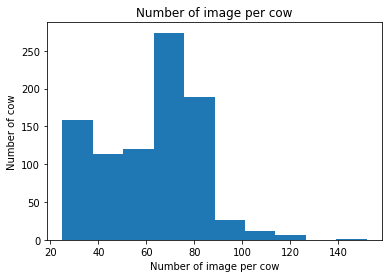

In [48]:
(trainCows,_) = analysis.summaryData(trainDirPath)

## Load our test data:



In [49]:
eidDict,dfDict=analysis.loadFv(datasetFn) 

## Compare to our test dataset


In [50]:
testCows=list(dict.fromkeys(dfDict['eids']))
print("Number of cow in Test: {}".format(len(testCows)))

common=[]
newCow=[]
for cow in testCows:
    if cow in trainCows:
        common.append(cow)
    else:
        newCow.append(cow)
print("Test cow in training set: {}".format(len(common)))
print("New cow: {}".format(len(newCow)))
print("Number of images: {}".format(len(dfDict['paths'])))


Number of cow in Test: 991
Test cow in training set: 702
New cow: 289
Number of images: 13380


# Glimpse with TSNE
* Clustering method.
* Project N dimension space into a XY plane
* Preserve neighbourhood and sacrifice long distance

### Showing the top (most image per cow) cluster :

In [51]:
numTopCow=20
eidTop,fvTop=analysis.selectTopCow(eidDict,numTopCow)

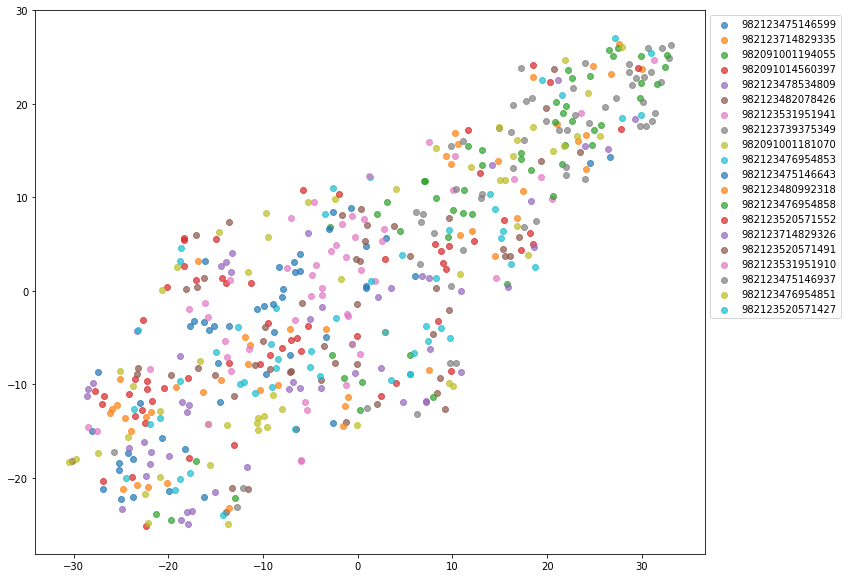

In [52]:
analysis.plotTSNE(eidTop,fvTop)

## Which are the similar cows ??

We want to see for the close clusters, how similar are those cow ??

In [53]:
data=analysis.computeClusterCentroid(eidDict)
d2Table=analysis.computeDistancePairs(data)

100%|█████████▉| 490545/491040.5 [00:04<00:00, 99112.15it/s] 


In [54]:
d2Table.head()

,d2,cowA,cowB
0,2.004398e-06,982091012162172,982123553042084
1,1.206016e-06,982091012162172,982123553042067
2,2.375208e-07,982091012162172,982123476954870
3,2.425800e-06,982091012162172,982091001181297
4,4.543987e-07,982091012162172,982123531951889


### Looking at the top close cluster :

Sort the table by distance

In [55]:
d2Table=d2Table.sort_values(by=['d2']).reset_index(drop=True)
d2Table['index'] = d2Table.index

The worst cluster distance

In [56]:
numTop=100
d2Table.head(numTop)
#w.plot(x='index',y='d2',kind='scatter')

,d2,cowA,cowB,index
0,1.073952e-08,982123553042079,982123553042245,0
1,1.074667e-08,982123553042102,982123739375390,1
2,1.102784e-08,982091001181279,982000189576052,2
3,1.126467e-08,982123553042024,982091001181323,3
4,1.155863e-08,982123520571548,982123520571403,4
...,...,...,...,...
95,2.071799e-08,982123475146559,982123553042063,95
96,2.074728e-08,982123475146803,982123732446226,96
97,2.075210e-08,982123553042102,982123553041958,97
98,2.076512e-08,982123739375351,982123531951991,98


### TSNE of the top 10 close cluster

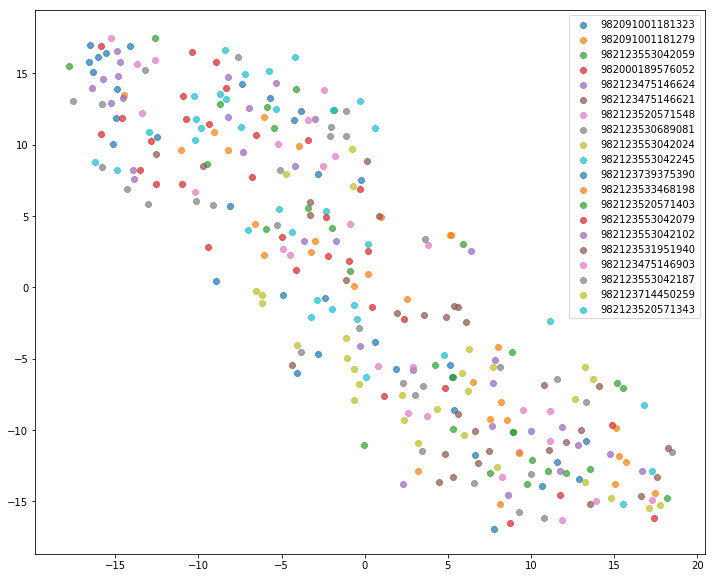

In [57]:
num=10
worstDf,eidBad,fvBad=analysis.plotWorstCluster(eidDict,d2Table,num)

In [58]:
worstDf

,d2,cowA,cowB,index
0,1.073952e-08,982123553042079,982123553042245,0
1,1.074667e-08,982123553042102,982123739375390,1
2,1.102784e-08,982091001181279,982000189576052,2
3,1.126467e-08,982123553042024,982091001181323,3
4,1.155863e-08,982123520571548,982123520571403,4
5,1.202237e-08,982123553042059,982123520571343,5
6,1.211814e-08,982123530689081,982123475146903,6
7,1.237134e-08,982123475146624,982123533468198,7
8,1.290660e-08,982123475146621,982123531951940,8
9,1.319874e-08,982123553042187,982123714450259,9


/data/gpueval/imageProcessing/peguo0/cowFace/analysis/worstCluster.png generated


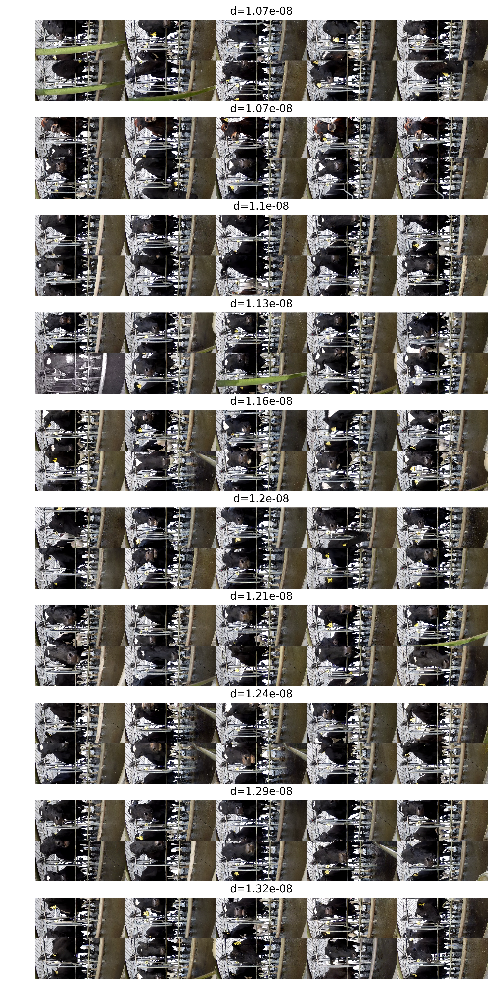

In [59]:
analysis.showWorstPairsHori(eidDict,worstDf)